In [ ]:
import os                        # for os.path.exists
import json                      # for loading metadata
import urllib                    # for downloading remote files
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import sklearn
import sklearn.tree
import sklearn.metrics
import sklearn.ensemble
import sklearn.preprocessing
import sklearn.linear_model

# Matplotlib might complain that a lot of figures are open, but suppress that warning.
plt.rcParams.update({'figure.max_open_warning': 0})

**Run the code cell below** to define some utility functions for fetching data and for processing images.

In [ ]:
def download(remoteurl: str, localfile: str):
    """
    Download remoteurl to localfile, unless localfile already exists.
    Returns the localfile string.
    """
    if not os.path.exists(localfile):
        print("Downloading %s..." % localfile)
        filename, headers = urllib.request.urlretrieve(remoteurl, localfile)
    return localfile

def rgba_to_rgb(image):
    """
    Converts image from RGBA format (H,W,4) to RGB format (H,W,3).
    Returns the new RGB image.
    """
    assert image.ndim == 3, "Expected 3-dimensional array"
    assert image.shape[2] == 4, "Expected 4 colour channels"
    assert image.max() <= 1, "Expected color values in range [0,1]"
    rgb, a = np.split(image, [3], axis=2)  # Split into (H,W,3) and (H,W,1)
    return a*rgb + (1-a)                   # Apply alpha blending to get RGB

<div style="border-bottom: 3px solid black; margin-bottom:5px"></div>
<div style="border-bottom: 3px solid black"></div>

# &mdash; Download emoji metadata and images

The image data and corresponding metadata is available from [github.com/imcal/emoji-data](https://github.com/iamcal/emoji-data), where you can also find a description of the data. The specific files you'll need are only:
* *emoji.json*
* *sheets-clean/sheet_{vendor}_{size}_clean.png*

where *{vendor}* is one of *{apple, facebook, google, twitter}* and *{size}* is the pixel resolution. We will use only the small *16x16* pixel versions (to make training faster).

<div style="border-bottom: 1px solid black;"></div>

### &mdash;  Write code to download the files

Use the *download* function defined above to fetch the five files *procedurally*.

When you visit a Github URL in your browser, Github normally returns an HTML file for rendering in your web browser. To ask Github for an actual raw file (instead of the web page for displaying that file) you must use special URLs. If you view a file in your web browser https://github.com/iamcal/emoji-data/{path_to_file} then you should use URL https://github.com/iamcal/emoji-data/raw/master/{path_to_file}.

In [ ]:
# Feel free to define global variables like EMOJI_SIZE=16 for later use.
emoji_json_url = 'https://raw.githubusercontent.com/iamcal/emoji-data/master/emoji.json'
emoji_apple_url = 'https://raw.githubusercontent.com/iamcal/emoji-data/master/sheets-clean/sheet_apple_16_clean.png'
emoji_facebook_url = 'https://raw.githubusercontent.com/iamcal/emoji-data/master/sheets-clean/sheet_facebook_16_clean.png'
emoji_google_url = 'https://raw.githubusercontent.com/iamcal/emoji-data/master/sheets-clean/sheet_google_16_clean.png'
emoji_twitter_url = 'https://raw.githubusercontent.com/iamcal/emoji-data/master/sheets-clean/sheet_twitter_16_clean.png'

emoji_json_file = download(emoji_json_url, 'emoji.json')
emoji_file = [download(emoji_apple_url, 'sheet_apple_16_clean.png')]
emoji_file.append(download(emoji_facebook_url, 'sheet_facebook_16_clean.png'))
emoji_file.append(download(emoji_google_url, 'sheet_google_16_clean.png'))
emoji_file.append(download(emoji_twitter_url, 'sheet_twitter_16_clean.png'))
print(type(emoji_json_file))
print(emoji_json_file)
print(type(emoji_file))
print(emoji_file)

<class 'str'>
emoji.json
<class 'list'>
['sheet_apple_16_clean.png', 'sheet_facebook_16_clean.png', 'sheet_google_16_clean.png', 'sheet_twitter_16_clean.png']


<div style="border-bottom: 1px solid black;"></div>

### &mdash;  Load and inspect the emoji metadata

The emoji metadata is contained in a JSON file, which Python's **[json](https://docs.python.org/3/library/json.html)** module can easily load and parse for you.

**Write code** to load the *emoji.json* file, then display the metadata for the first emoji (index 0) so that you can see an example. It should have short name '*hash*'.

In [ ]:
# Keep the metadata in a global variable that you can keep referring to.
with open(emoji_json_file) as file:
    emoji_meta = json.load(file)
print(emoji_meta[0])
print(type(emoji_meta))
print(len(emoji_meta))

{'name': 'HASH KEY', 'unified': '0023-FE0F-20E3', 'non_qualified': '0023-20E3', 'docomo': 'E6E0', 'au': 'EB84', 'softbank': 'E210', 'google': 'FE82C', 'image': '0023-fe0f-20e3.png', 'sheet_x': 0, 'sheet_y': 0, 'short_name': 'hash', 'short_names': ['hash'], 'text': None, 'texts': None, 'category': 'Symbols', 'subcategory': 'keycap', 'sort_order': 1521, 'added_in': '0.6', 'has_img_apple': True, 'has_img_google': True, 'has_img_twitter': True, 'has_img_facebook': False}
<class 'list'>
1875


**Code** to find the index of the emoji having short name *'laughing'*, then display its metadata (the *dict* object).

In [ ]:
laughing_index = next((i for (i, emoji) in enumerate(emoji_meta) if emoji['short_name'] == 'laughing'), None)
print(emoji_meta[laughing_index])

{'name': 'SMILING FACE WITH OPEN MOUTH AND TIGHTLY-CLOSED EYES', 'unified': '1F606', 'non_qualified': None, 'docomo': 'E72A', 'au': 'EAC5', 'softbank': None, 'google': 'FE332', 'image': '1f606.png', 'sheet_x': 32, 'sheet_y': 27, 'short_name': 'laughing', 'short_names': ['laughing', 'satisfied'], 'text': None, 'texts': [':>', ':->'], 'category': 'Smileys & Emotion', 'subcategory': 'face-smiling', 'sort_order': 5, 'added_in': '0.6', 'has_img_apple': True, 'has_img_google': True, 'has_img_twitter': True, 'has_img_facebook': True}


<div style="border-bottom: 1px solid black;"></div>

### &mdash;  Load and inspect the emoji image data
The emoji image data is contained in PNG files, which Matplotlib's **[imread](https://matplotlib.org/3.3.2/api/_as_gen/matplotlib.pyplot.imread.html)** function can load as a Numpy array. The image format is RGBA (*red*, *green*, *blue*, *alpha*) where *alpha* determines the opacity of each pixel.

**Code** to load the four emoji sheet images. The list of images should be in order *{apple,facebook,google,twitter}*.

In [ ]:
emoji_list = [plt.imread(file) for file in emoji_file]
print(emoji_list[0].shape)

(1098, 1098, 4)


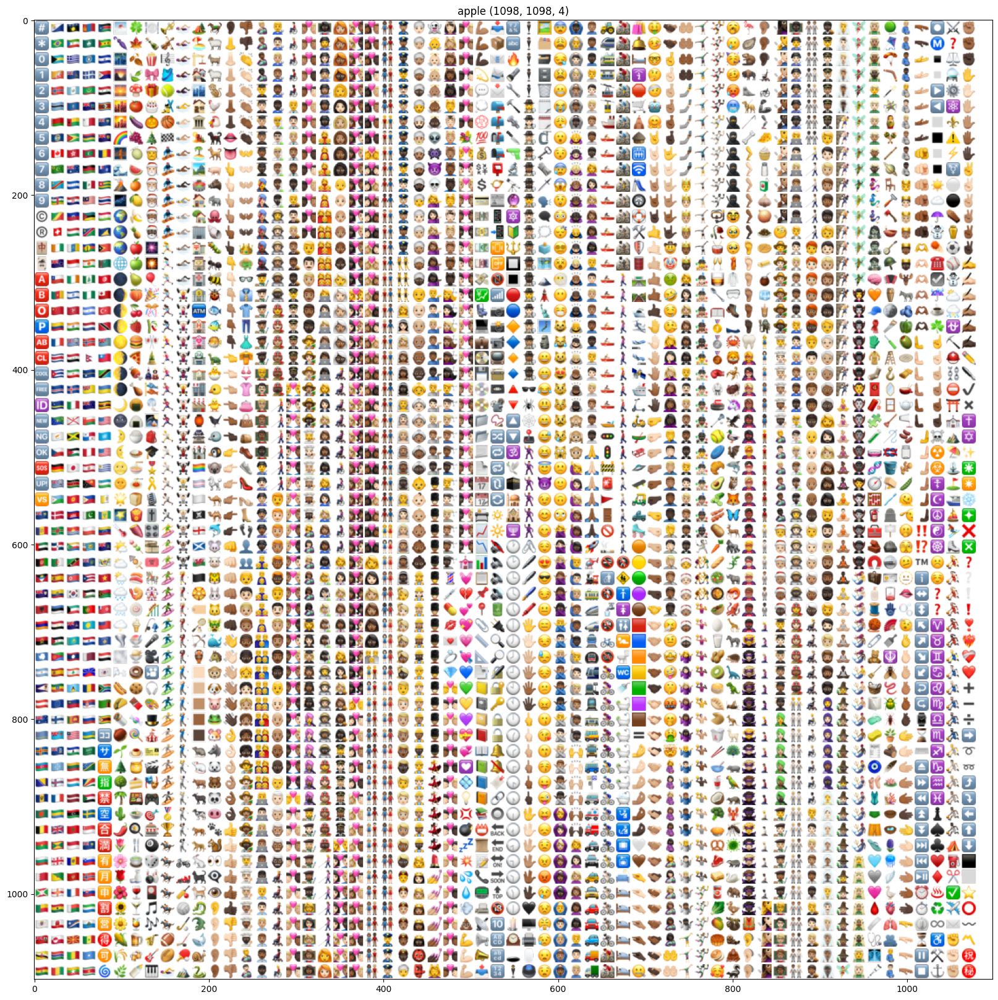

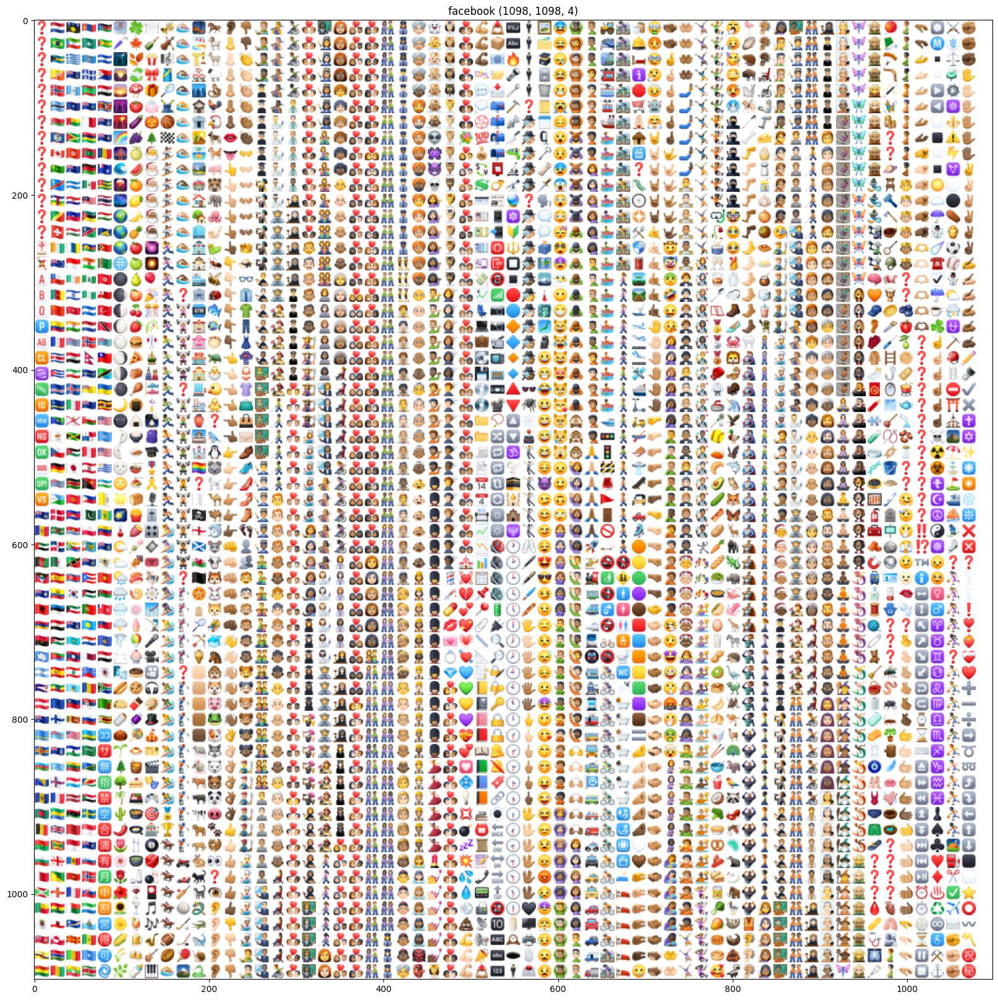

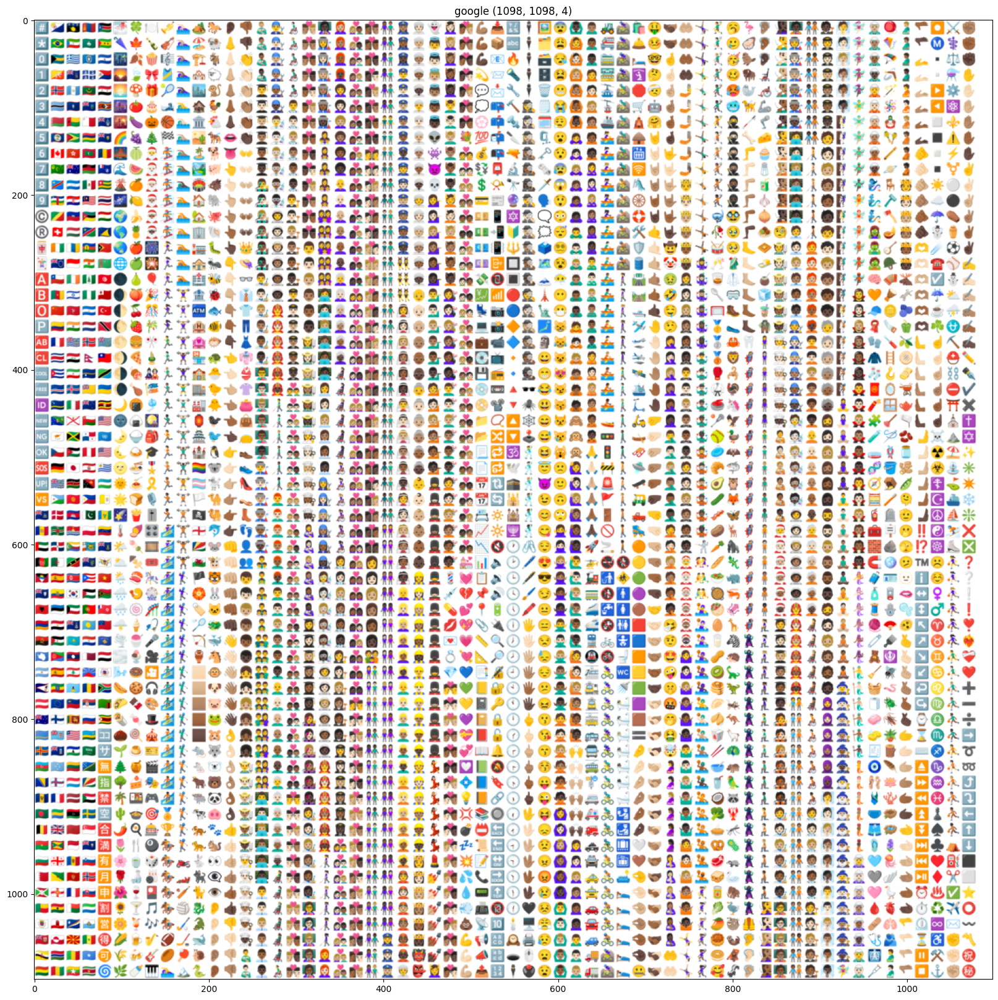

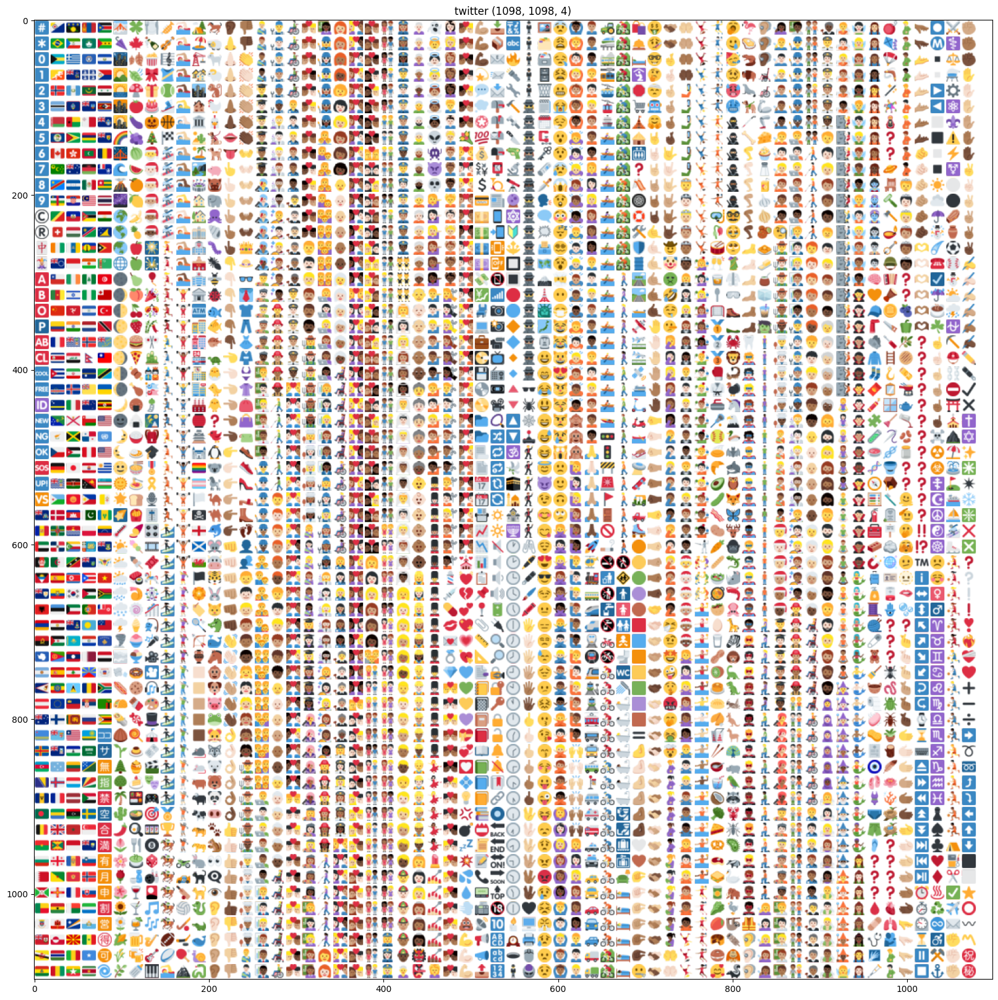

In [ ]:
for i, name in enumerate(['apple','facebook','google','twitter']):
    fig = plt.figure(figsize=(20,100))
    plt.imshow(emoji_list[i])
    plt.title("%s %s" % (name, emoji_list[i].shape))

**Code** to generate the same four plots as above, except use Numpy slicing to display only the first 3 rows and 8 columns of the sheet. To ensure you do not crop any emojis, take note of any "padding" between the 16x16 emojis in the sheet.

(If you see a red question mark like <span style="color:red">?</span> for a vendor, it means they do not provide that particular emoji.)

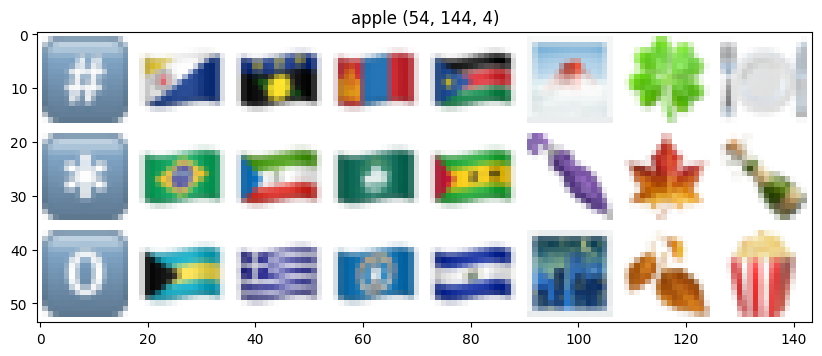

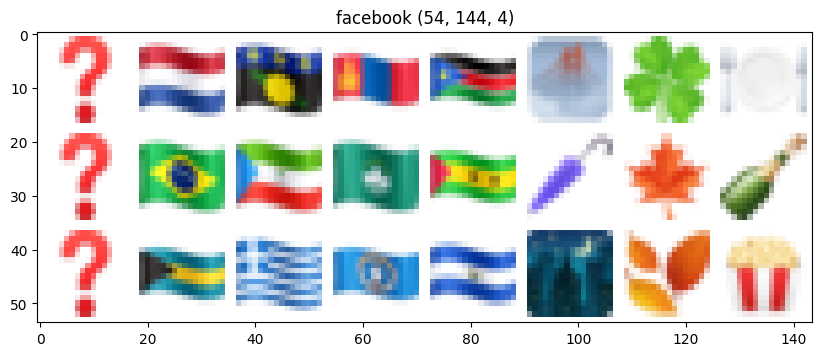

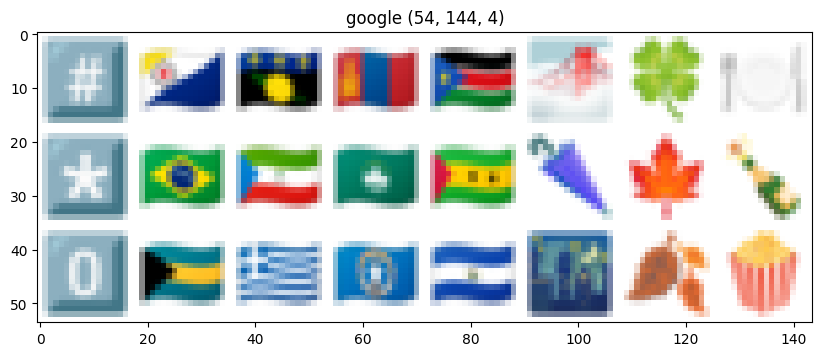

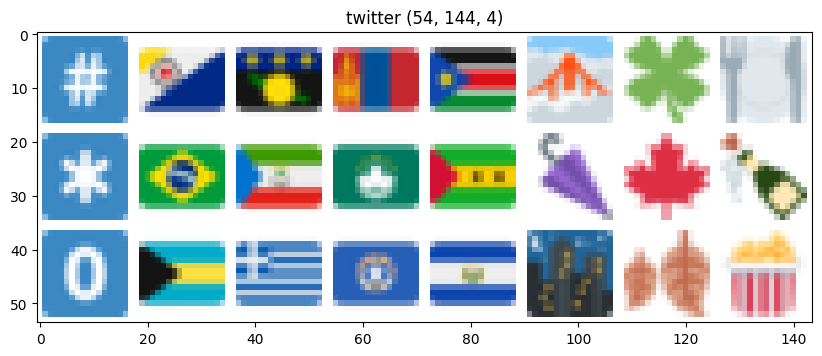

In [ ]:
for i, name in enumerate(['apple','facebook','google','twitter']):
    fig = plt.figure(figsize=(10,10))
    image = emoji_list[i][0:18*3,0:18 * 8]
    plt.imshow(image)
    plt.title("%s %s" % (name, image.shape))

***get_emoji_image*.** It should extract a 16x16 RGBA emoji image by its style index (0=*apple*, 1=*facebook*, 2=*google*, 3=*twitter*) and emoji index (as they appear in *emoji.json*). Internally, your function may refer to any global variables you have already defined (metadata, images, size, padding). Use the *sheet_x* and *sheet_y* fields of the metadata. Use slicing and avoid for-loops.

In [ ]:
def get_emoji_image(style_index, emoji_index):
    """
    Given a vendor style index (apple=0,facebook=1,google=2,twitter=3)
    and an emoji index, returns the 16x16 RGBA image as a Numpy array
    with shape (16,16,4).
    """
    sheet_x = emoji_meta[emoji_index]['sheet_x'] # This is to take the sheet_x from the metadata of emogies
    sheet_y = emoji_meta[emoji_index]['sheet_y'] # This is to take the sheet_y from the metadata of emogies
    emoji = emoji_list[style_index] # This is to retrieve the vendor sheet for one of the vendors that we have{apple, google,..}.
    image = emoji[sheet_y * 18: (sheet_y + 1) * 18, sheet_x * 18: (sheet_x + 1) * 18] # This considers the emoji_index which is the index of emoji by 16*16 and use padding for the extracted emoji as well.
    return image[1:17,1:17]

#A = get_emoji_image(0,0)
#print(A.shape)
#print(A)

***plot_emoji_styles*.** Implement the *plot_emoji_styles* function below, using your *get_emoji_image* function as a subroutine. Use *figsize* to control the size of your figure, use Matplotlib's *subplot* and *title* functions along with its **[suptitle](https://matplotlib.org/3.3.2/api/_as_gen/matplotlib.pyplot.suptitle.html)** to create titles that show the emoji index, the emoji short name, and the vendor title above each style.

In [ ]:
def plot_emoji_styles(emoji_index):
    """Plots all four vendor styles of the given emoji."""
    fig,ax =  plt.subplots(1,4, figsize=(10, 3))
    fig.suptitle('%d %s'%(emoji_index, emoji_meta[emoji_index]['short_name']))
    for i, title in enumerate(['apple','facebook','google','twitter']):
        ax[i].imshow(get_emoji_image(i,emoji_index))
        ax[i].set_title(title)

**Run *plot_emoji_styles*** function to plot the '*laughing*' emoji. Also plot two other emojis of your choosing. (Except poop. You're not allowed to plot the poop emoji. Don't you dare. No, no wait stop, have some self-respect, don't do it, noooo!)

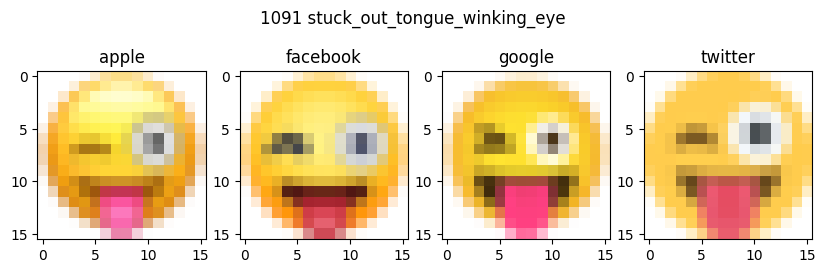

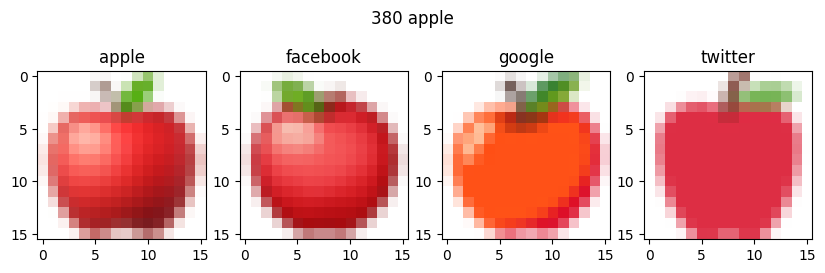

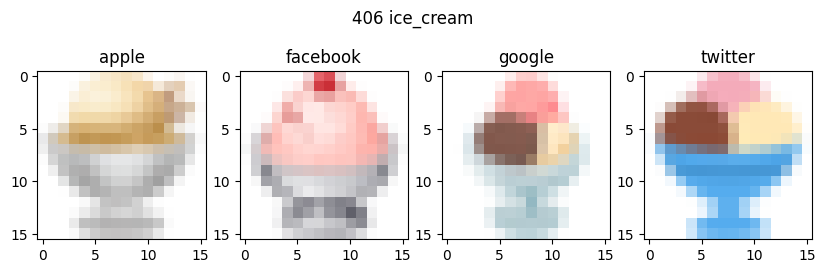

In [ ]:
plot_emoji_styles(next((i for (i, emoji) in enumerate(emoji_meta) if emoji["short_name"] == "stuck_out_tongue_winking_eye"), None))
plot_emoji_styles(next((i for (i, emoji) in enumerate(emoji_meta) if emoji["short_name"] == "apple"), None))
plot_emoji_styles(next((i for (i, emoji) in enumerate(emoji_meta) if emoji["short_name"] == "ice_cream"), None))

<div style="border-bottom: 3px solid black; margin-bottom:5px"></div>
<div style="border-bottom: 3px solid black"></div>

# Build an emoji dataset for machine learning

This part is about converting your list of four raw image sheets into a dataset $(\boldsymbol{X},\boldsymbol{y})$ suitable for training with scikit-learn.

<div style="border-bottom: 1px solid black;"></div>

### Build a set of inputs $\boldsymbol{X}$ from the sheet images

**Write code** to build a Numpy array of inputs $\boldsymbol{X}$ having dtype *float32* and shape $(N,D)$ where $N$ is the total number of emoji images (number of emojis $\times$ number of vendors) and $D$ is the total number of pixels per emoji (height $\times$ width $\times$ channels). Each image should be converted from RGBA (4 channels) to RGB (3 channels) using the *rgba_to_rgb* function defined at the top of this lab. The first rows of $\boldsymbol{X}$ should all be apple emojis, followed by all facebook emojis, then all google emojis, and finally the last rows should be all twitter emojis. <span style="color:#080;font-weight:bold">Briefly comment each non-trivial line of code.</span>

In [ ]:
# Q1a Code _ Build a set of inputs X from the sheet images

# Initialize an empty list to store the images
images = []

# Loop through each vendor style index (0: Apple, 1: Facebook, 2: Google, 3: Twitter)
for style_index in range(4):
    # Loop through each emoji in the meta-emoji list
    for emoji_index in range(len(emoji_meta)):
        # Use the get_emoji_image function to retrieve and returns the 16x16 RGBA image as a NP array with shape (16,16,4)
        emoji_image = get_emoji_image(style_index, emoji_index)
        # Convert RGBA to RGB using the defined function
        emoji_image_rgb = rgba_to_rgb(emoji_image)
        # Flatten the image to a 1D array and append to the list
        images.append(emoji_image_rgb.flatten())


# Convert the list of images to a NumPy array
X = np.array(images, dtype=np.float32)

# Display the shape of X
print("Shape of X:", X.shape)

Shape of X: (7500, 768)


**Plot a row of your $\boldsymbol{X}$.** Demonstrate that the rows of your $\boldsymbol{X}$ matrix is an emoji image. Do so by accessing a single row of $\boldsymbol{X}$ and plotting it as a $16 \times 16$ RGB image.

Example First Image (reshaped):


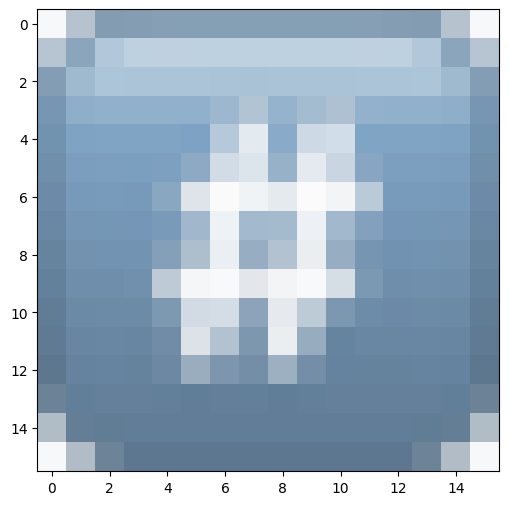

In [ ]:
# Define the shape of the emoji
emoji_shape = (16, 16, 3)
# Reshape and display the first image for verification
first_image = X[0].reshape(emoji_shape)

print("Example First Image (reshaped):")
fig = plt.figure(figsize=(8,6))
plt.imshow(first_image)

<div style="border-bottom: 1px solid black;"></div>

### Build a set of targets $\boldsymbol{y}$ from the metadata

Here you'll enumerate the distinct emoji categories, and then build a vector of integer targets $\boldsymbol{y}$.

**Write code** to get a list of distinct emoji categories, using the *category* field from the metadata. ensure that your list of categories is also displayed when the code cell below is executed.

In [ ]:
# Initialize an empty set to store distinct emoji labels
distinct_emoji_labels = set()

# Loop through the metadata
for emoji_info in emoji_meta:
    # Extract the labels from the "category" field
    category = emoji_info.get("category", None)
    if category is not None:
        # Add the category to the set to ensure uniqueness
        distinct_emoji_labels.add(category)

# Convert the set of distinct emoji labels to a list for display
distinct_emoji_labels_list = sorted(list(distinct_emoji_labels))

# Display the list of distinct emoji labels
print("Distinct Emoji labels:")
print(distinct_emoji_labels_list)

Distinct Emoji labels:
['Activities', 'Animals & Nature', 'Component', 'Flags', 'Food & Drink', 'Objects', 'People & Body', 'Smileys & Emotion', 'Symbols', 'Travel & Places']


**Write code** to build a Numpy array of inputs $\boldsymbol{y}$ having dtype *int32* and where $y_i \in \{0, \ldots, M-1\}$ with $M$ being the number of distinct emoji categories. The order of items in $\boldsymbol{y}$ should match those of $\boldsymbol{X}$ from **Q1a**. You may use any approach you like, but potentially useful functions include the *list* object's **[index](https://docs.python.org/3/tutorial/datastructures.html)** function and Numpy's **[np.tile](https://numpy.org/doc/stable/reference/generated/numpy.tile.html)** function. <span style="color:#080;font-weight:bold">

In [ ]:
# Initialize an empty list to store the labels
emoji_labels = []

# Loop through each vendor style index (0: Apple, 1: Facebook, 2: Google, 3: Twitter)
for style_index in range(4):
  # Loop through each entry in the metadata
  for emoji_info in emoji_meta:
    # Extract the category from the "category" field
    category = emoji_info.get('category', None)
    if category is not None:
        # Find the index of the category in the distinct labels list
        label_index = distinct_emoji_labels_list.index(category)
        # Append the label index to the list for each vendor
        emoji_labels.extend([label_index])

# Convert the list of labels to a NumPy array with dtype int32
y = np.array(emoji_labels, dtype=np.int32)

# Display the shape of y
print(y)
print("Shape of y:", y.shape)
print(y[-6])

[8 8 8 ... 8 8 8]
Shape of y: (7500,)
9


**Write code** to demonstrate that, for each training example $i$ corresponding to a '*laughing*' emoji (for apple, facebook, google, twitter), its $y_i$ label is set to be the index of the "Smileys & Emotion" category.

In [ ]:
# Initialize an empty list to store the labels
emoji_labels = []

# Loop through each vendor style index (0: Apple, 1: Facebook, 2: Google, 3: Twitter)
for style_index in range(4):
    # Loop through each entry in the metadata
    for emoji_info in emoji_meta:
        # Extract the category from the "category" field
        category = emoji_info.get('category', None)
        if category is not None:
            # Find the index of the category in the distinct labels list
            label_index = distinct_emoji_labels_list.index(category)

            # Check if the emoji is 'laughing' and set the label accordingly
            if emoji_info['short_name'] == 'laughing':
                label_index = distinct_emoji_labels_list.index('Smileys & Emotion')

            # Append the label index to the list for each vendor
            emoji_labels.append(label_index)

# Convert the list of labels to a NumPy array with dtype int32
y = np.array(emoji_labels, dtype=np.int32)

# Display the shape of y
print(y)
print("Shape of y:", y.shape)

[8 8 8 ... 8 8 8]
Shape of y: (7500,)


<div style="border-bottom: 1px solid black;"></div>

### Split and preprocess the data
**Write code** to randomly split $(\boldsymbol{X}, \boldsymbol{y})$ into three parts, with no overlap:
1. a *training* set $(\boldsymbol{X}_\text{trn}, \boldsymbol{y}_\text{trn})$, which you will use to directly train classifiers
2. a *validation* set $(\boldsymbol{X}_\text{val}, \boldsymbol{y}_\text{val})$, which you will use to estimate the best value for a hyperparameter
3. a *test* set $(\boldsymbol{X}_\text{tst}, \boldsymbol{y}_\text{tst})$, which you will use to evaluate final performance of the 'best' hyperparameters

The training data should comprise 60% of the full data set. The validation and testing data should each comprise 20% of the original data. Use the **[train_test_split](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html)** function and remember to set *random_state*.

In [ ]:
# Q1c - Randomly splite the data into three parts training, validation, and test

# import train_test_split function
from sklearn.model_selection import train_test_split

# X_mid and y_mid for firstly split the data set first to 60% training and then to 20% for validation and testing
X_train, X_mid, y_train, y_mid = train_test_split(X, y, test_size=0.4, random_state=42)  # random_state = 42 for reproduciblity
X_val, X_test, y_val, y_test = train_test_split(X_mid, y_mid, test_size=0.5, random_state=42 )

# Display the shapes of the resulting sets
print("Shape of X_train:", X_train.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of X_val:", X_val.shape)
print("Shape of y_val:", y_val.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_test:", y_test.shape)

Shape of X_train: (4500, 768)
Shape of y_train: (4500,)
Shape of X_val: (1500, 768)
Shape of y_val: (1500,)
Shape of X_test: (1500, 768)
Shape of y_test: (1500,)


**Write code** to normalize the features of $\boldsymbol{X}_\text{trn}$, $\boldsymbol{X}_\text{val}$, and $\boldsymbol{X}_\text{tst}$, using scikit-learn's **[StandardScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)**. Be careful which subset of the data you use for estimating the *StandardScaler* object's *scale_* and *mean_* attributes.

In [ ]:
from sklearn.preprocessing import StandardScaler

# Initialize the StandardScaler
scaler = StandardScaler()

# Fit the scaler on the training data and transform X_train
X_train_scaled = scaler.fit_transform(X_train)

# Use the same scaler to transform X_val and X_test
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

**Plot a scaled and unscaled emoji side-by-side.** Choose a row from $\boldsymbol{X}_\text{trn}$ and show how it appears as an RGB image with and without scaling. If Matplotlib complains that "values are not in range [0,1]," consider using **[np.clip](https://numpy.org/doc/stable/reference/generated/numpy.clip.html)**.

*Hint:* You do not need to know which row in $\boldsymbol{X}_\text{trn}$ corresponds to which row in $\boldsymbol{X}$. Instead you can "undo" the scaling on whatever row you pick, using one of the methods provided by *StandardScaler*.

"# Apply scaling and undo scaling on the chosen row\n\n# Plot the original and scaled emojis side-by-side\nfig, axes = plt.subplots(1, 3, figsize=(12, 4))\n\naxes[0].imshow(rgba_to_rgb(emoji_original))\naxes[0].set_title('Original Emoji')\naxes[0].axis('off')\n\naxes[1].imshow(rgba_to_rgb(np.clip(emoji_scaled, 0, 1)))  # Use np.clip to ensure values are in [0, 1]\naxes[1].set_title('Scaled Emoji')\naxes[1].axis('off')\n\naxes[2].imshow(rgba_to_rgb(np.clip(emoji_unscaled, 0, 1)))  # Use np.clip to ensure values are in [0, 1]\naxes[2].set_title('Unscaled Emoji')\naxes[2].axis('off')\n\nplt.show()"

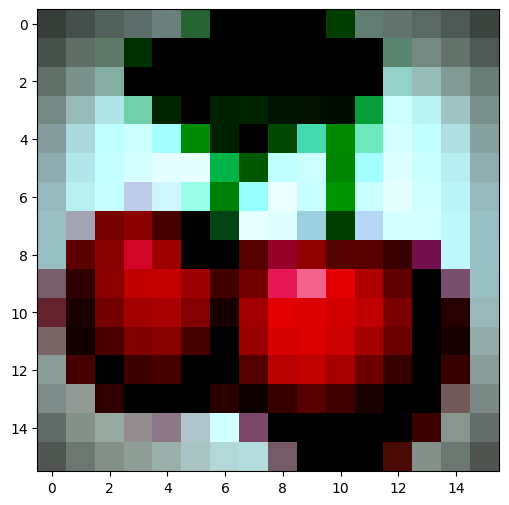

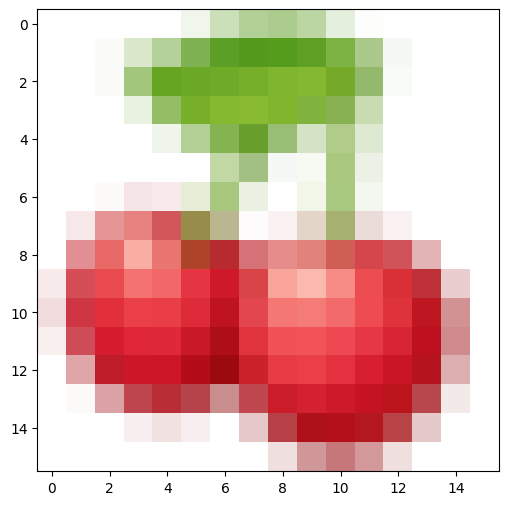

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

# Assuming you have X_train, scaler, and rgba_to_rgb function defined
# Initialize the StandardScaler
scaler = StandardScaler()

# Fit the scaler on the training data and transform X_train
X_train_scaled = scaler.fit_transform(X_train)

# Choose a row from X_train
row_index = 16
#emoji_original = X_train[row_index].reshape((16, 16, 3))  # Reshape to original shape

emoji_scaled_example = X_train_scaled[row_index].reshape(16, 16, 3)
#emoji_scaled = scaler.fit_transform([X_train[row_index]])[0].reshape((16, 16, 3))
emoji_scaled_example_2 = np.clip(emoji_scaled_example, 0, 1)

emoji_unscaled_example = scaler.inverse_transform(X_train_scaled)[row_index].reshape((16, 16, 3))


fig = plt.figure(figsize=(8,6))
plt.imshow(emoji_scaled_example_2)

fig = plt.figure(figsize=(8,6))
plt.imshow(emoji_unscaled_example)

<div style="border-bottom: 3px solid black; margin-bottom:5px"></div>
<div style="border-bottom: 3px solid black"></div>

# Train classifiers and identify good hyperparameters

This part has several goals:
1. to help you visualize how hyperparameters affect training/validation/test performance.
2. to give you a sense for how long certain classifiers take to train or to make predictions.
3. to force you to try two useful Python language features: (a) passing types as arguments, and (b) argument forwarding.

(However, please take the hyperparameter search lab as a better example of how to use scikit-learn for hyperparameter search; this assignment is focused on making things easy to plot and visualize, not on automating the search itself.)

<div style="border-bottom: 1px solid black;"></div>

### Write a utility function that trains multiple estimators

Throughout this part, you will be training multiple estimators, each with a different hyperparameter setting.

**Implement the *train_estimators* utility function.** The idea of this function is to make it easy to train multiple versions of an estimator where one hyperparameter (specified by *param_name*) gets to take on a different value (specified by *param_vals*) for each instance. See the docstring below. *Hint:* Look at scikit-learn's [BaseEstimator](https://scikit-learn.org/stable/modules/generated/sklearn.base.BaseEstimator.html) class documentation.

In [ ]:
from sklearn.tree import DecisionTreeClassifier

def train_estimators(base_estimator, X, y, param_name, param_vals):
    """
    Train models with different parameter values and return a list of trained models.

    Parameters:
    - base_estimator: Base classifier (e.g., DecisionTreeClassifier)
    - X: Input features
    - y: Target labels
    - param_name: Name of the parameter to vary
    - param_vals: List of parameter values to try

    Returns:
    - List of trained models
    """
    models = []

    for param_val in param_vals:
        # Create a copy of the base estimator with the specified parameter value
        model = base_estimator(**{param_name: param_val})

        # Train the model on the data
        model.fit(X, y)

        # Append the trained model to the list
        models.append(model)

    return models

**Run the code cell below** to test your implementation of *train_estimators*. (Replace *X_trn* and *y_trn* with whatever you called your training set variables.)

In [ ]:
# Create an instance of BaseEstimator(In this case DecisionTreeClassifier) with specific hyperparameters
DecisionTree_estimator = DecisionTreeClassifier(splitter='random', random_state=0)

# Use the instance in train_estimators function with param_name = 'max_depth' and param_vals = [1, 5, 10]
tree_param_name = 'max_depth'
tree_param_vals = [1, 5, 10]
tree_estimators = train_estimators(DecisionTree_estimator.__class__, X_train_scaled, y_train, tree_param_name, tree_param_vals)

# Print the list of trained models
print(tree_estimators)

[DecisionTreeClassifier(max_depth=1), DecisionTreeClassifier(max_depth=5), DecisionTreeClassifier(max_depth=10)]


<div style="border-bottom: 1px solid black;"></div>

### Train multiples models, plot their accuracies, and identify good parameters
**Implement the *score_estimators* utility function.** This will be handy for scoring a list of estimators on a particular data set, such as $(\boldsymbol{X}_\text{trn}, \boldsymbol{y}_\text{trn})$. Use the estimator's own *score* method.

In [ ]:
def score_estimators(X, y, estimators):
    """Scores each estimator on (X, y), returning a list of scores."""
    scores = []

    for estimator in estimators:
      score = estimator.score(X,y)
      scores.append(score)

    return scores

**Run the code cell below** to test your implementation. It should print three scores per dataset. Each score is a measure of classification accuracy. (Replace *X_trn* and *y_trn* etc with your dataset variable names.)

In [ ]:
print("train:   ", score_estimators(X_train_scaled, y_train, tree_estimators))
print("validate:", score_estimators(X_val_scaled, y_val, tree_estimators))
print("test:    ", score_estimators(X_test_scaled, y_test, tree_estimators))

train:    [0.31266666666666665, 0.5748888888888889, 0.8142222222222222]
validate: [0.32066666666666666, 0.5233333333333333, 0.558]
test:     [0.30866666666666664, 0.536, 0.558]


You should see that the 3rd column (corresponding to *max_depth=15*) performs best, especially on training.

**Run the code cell below** to see a demonstration of the `%%time` feature of Jupyter (see [here](https://ipython.readthedocs.io/en/stable/interactive/magics.html#magic-time)). Note that `%%time` only works if it is the first line in a code cell, before any comments.

In [ ]:
%%time
for i in range(1000000):  # Burn some CPU cycles in a
    pass                  # loop that does nothing

CPU times: user 48.4 ms, sys: 332 µs, total: 48.7 ms
Wall time: 51.2 ms


**Train multiple *DecisionTreeClassifier*s** on the training set, such that *train_estimators* produces the following output:

    Training DecisionTreeClassifier(max_depth=1, random_state=0, splitter='random')...
    Training DecisionTreeClassifier(max_depth=5, random_state=0, splitter='random')...
    Training DecisionTreeClassifier(max_depth=10, random_state=0, splitter='random')...
    Training DecisionTreeClassifier(max_depth=20, random_state=0, splitter='random')...
    Training DecisionTreeClassifier(max_depth=50, random_state=0, splitter='random')...
    Training DecisionTreeClassifier(max_depth=100, random_state=0, splitter='random')...

In [ ]:
%%time
# Create an instance of BaseEstimator(In this case DecisionTreeClassifier) with specific hyperparameters
DecisionTree_estimator = DecisionTreeClassifier(splitter='random', random_state=0)

# Use the instance in train_estimators function with param_name = 'max_depth' and param_vals = [1, 5, 10, 20, 50, 100]
tree_param_name = 'max_depth'
tree_param_vals_2 = [1, 5, 10, 20, 50, 100]
tree_estimators = train_estimators(DecisionTree_estimator.__class__, X_train_scaled, y_train, tree_param_name, tree_param_vals_2)

# Print the list of trained models
print(tree_estimators)

[DecisionTreeClassifier(max_depth=1), DecisionTreeClassifier(max_depth=5), DecisionTreeClassifier(max_depth=10), DecisionTreeClassifier(max_depth=20), DecisionTreeClassifier(max_depth=50), DecisionTreeClassifier(max_depth=100)]
CPU times: user 14.7 s, sys: 15.3 ms, total: 14.7 s
Wall time: 14.7 s


In [ ]:
train_scores_tree = score_estimators(X_train_scaled, y_train, tree_estimators)
val_scores_tree = score_estimators(X_val_scaled, y_val, tree_estimators)
test_scores_tree = score_estimators(X_test_scaled, y_test, tree_estimators)

print("DecisionTree train scores:   ", train_scores_tree)
print("DecisionTree validate scores:", val_scores_tree)
print("DecisionTree test scores:    ", test_scores_tree)

DecisionTree train scores:    [0.31266666666666665, 0.5748888888888889, 0.8144444444444444, 0.994, 0.9944444444444445, 0.9944444444444445]
DecisionTree validate scores: [0.32066666666666666, 0.5233333333333333, 0.552, 0.5566666666666666, 0.5626666666666666, 0.5686666666666667]
DecisionTree test scores:     [0.30866666666666664, 0.536, 0.558, 0.5526666666666666, 0.5566666666666666, 0.5613333333333334]


**Implement *plot_estimator_scores*** to visualize the effect of the parameter on accuracy. When applied to the decision tree estimators you trained in the previous cell, the plot should include legend, colours, marks, and x-axis ticks, but your precise scores may differ depending on how you decided to split the data.

*Hint:* You can use your *score_estimators* implementation, but do not do any training.

*Hint:* For the title, you can get the object's type from its `__class__` attribute, and you can get the name of its type from the type's `__name__` attribute. Use the first object in *estimators* to determine the name of the classifier type that you're plotting.

*Hint:* If your $x$-axis points are not evenly spaced, you can plot each series using any evenly-spaced $x$ values (e.g. via *np.arange*) and then override the $x$-axis tick labels with whatever you want. See the *labels* argument of Matplotlib's **[xticks](https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.xticks.html)** function.

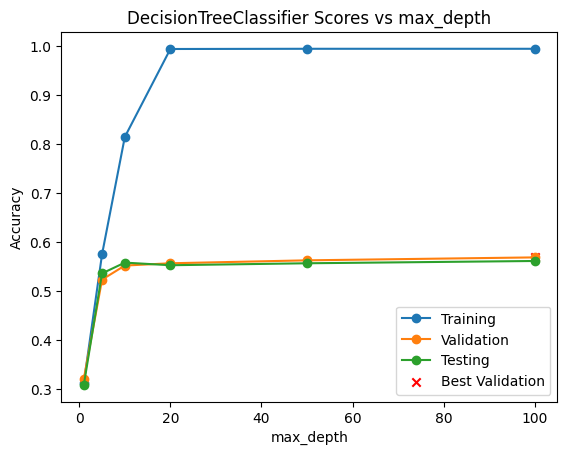

In [ ]:
def plot_estimator_scores_DT(estimators, param_name, param_vals):
    """
    Plots the training, validation, and testing scores of a list of estimators,
    where `param_name` and `param_vals` are the same as for `train_estimators`.
    The estimator with the best validation score will be highlighted with an 'x'.
    """
    # Plotting
    plt.plot(param_vals, train_scores_tree, label='Training', marker='o')
    plt.plot(param_vals, val_scores_tree, label='Validation', marker='o')
    plt.plot(param_vals, test_scores_tree, label='Testing', marker='o')

    # Highlight the best validation score with an 'x'
    best_val_index = np.argmax(val_scores_tree)
    plt.scatter(param_vals[best_val_index], val_scores_tree[best_val_index], marker='x', color='red', label='Best Validation')

    # Set plot labels and title
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.title(f'{estimators[0].__class__.__name__} Scores vs {param_name}')
    plt.legend()
    plt.show()


tree_param_name = 'max_depth'
tree_param_vals_2 = [1, 5, 10, 20, 50, 100]
# Example usage with DecisionTreeClassifier
plot_estimator_scores_DT(tree_estimators, tree_param_name, tree_param_vals_2)

**Plot the *DecisionTreeClassifier* scores** by calling your *plot_estimator_scores* function. Your plot should look like the example plot.

**Train multiple *RandomForestClassifiers*** such that *train_estimators* produces the following output:

    Training RandomForestClassifier(max_depth=1, random_state=0)...
    Training RandomForestClassifier(max_depth=5, random_state=0)...
    Training RandomForestClassifier(max_depth=10, random_state=0)...
    Training RandomForestClassifier(max_depth=20, random_state=0)...
    Training RandomForestClassifier(max_depth=50, random_state=0)...
    Training RandomForestClassifier(max_depth=100, random_state=0)...

In [ ]:
%%time
from sklearn.ensemble import RandomForestClassifier
# Create an instance of BaseEstimator(In this case RandomForest) with 'gini' criterion
RandomForest_estimator_gini = RandomForestClassifier(criterion='gini', random_state=0)

# Create an instance of BaseEstimator(In this case RandomForest) with 'entropy' criterion
RandomForest_estimator_entropy = RandomForestClassifier(criterion='entropy', random_state=0)

# Use the instance in RandomForest_estimators function with param_name = 'max_depth' and param_vals = [1, 5, 10, 20, 50, 100]
RF_param_name = 'max_depth'
RF_param_vals = [1, 5, 10, 20, 50, 100]

RF_gini_estimators = train_estimators(RandomForest_estimator_gini.__class__, X_train_scaled, y_train, RF_param_name, RF_param_vals)
RF_entropy_estimators = train_estimators(RandomForest_estimator_entropy.__class__, X_train_scaled, y_train, RF_param_name, RF_param_vals)


# Print the list of trained models
print('Training RandomForestClassifier with gini criterion')
print(RF_gini_estimators)
print('')
print('============================================================================================================')
print('')
print('Training RandomForestClassifier with entropy criterion')
print(RF_entropy_estimators)

Training RandomForestClassifier with gini criterion
[RandomForestClassifier(max_depth=1), RandomForestClassifier(max_depth=5), RandomForestClassifier(max_depth=10), RandomForestClassifier(max_depth=20), RandomForestClassifier(max_depth=50), RandomForestClassifier(max_depth=100)]


Training RandomForestClassifier with entropy criterion
[RandomForestClassifier(max_depth=1), RandomForestClassifier(max_depth=5), RandomForestClassifier(max_depth=10), RandomForestClassifier(max_depth=20), RandomForestClassifier(max_depth=50), RandomForestClassifier(max_depth=100)]
CPU times: user 1min 16s, sys: 219 ms, total: 1min 16s
Wall time: 1min 19s


**Plot the *RandomForestClassifier* scores**, again by calling your *plot_estimator_scores* function.

RF_gini train scores:     [0.3171111111111111, 0.6222222222222222, 0.968, 0.9944444444444445, 0.9944444444444445, 0.9944444444444445]
RF_gini validate scores:  [0.324, 0.5706666666666667, 0.6973333333333334, 0.7133333333333334, 0.7146666666666667, 0.72]
RF_gini test scores:      [0.31266666666666665, 0.574, 0.6853333333333333, 0.718, 0.7153333333333334, 0.7113333333333334]


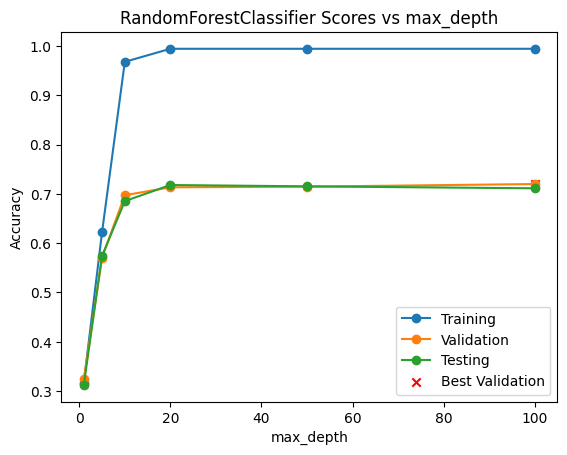

CPU times: user 1.48 s, sys: 112 ms, total: 1.59 s
Wall time: 1.47 s


In [ ]:
%%time
# Random Forest with "Gini" Criterion
train_scores_RF_gini = score_estimators(X_train_scaled, y_train, RF_gini_estimators)
val_scores_RF_gini = score_estimators(X_val_scaled, y_val, RF_gini_estimators)
test_scores_RF_gini = score_estimators(X_test_scaled, y_test, RF_gini_estimators)

print("RF_gini train scores:    ", train_scores_RF_gini)
print("RF_gini validate scores: ", val_scores_RF_gini)
print("RF_gini test scores:     ", test_scores_RF_gini)

def plot_estimator_scores_RF_gini(estimators, param_name, param_vals):
    """
    Plots the training, validation, and testing scores of a list of estimators,
    where `param_name` and `param_vals` are the same as for `train_estimators`.
    The estimator with the best validation score will be highlighted with an 'x'.
    """
    # Plotting
    plt.plot(param_vals, train_scores_RF_gini, label='Training', marker='o')
    plt.plot(param_vals, val_scores_RF_gini, label='Validation', marker='o')
    plt.plot(param_vals, test_scores_RF_gini, label='Testing', marker='o')

    # Highlight the best validation score with an 'x'
    best_val_index = np.argmax(val_scores_RF_gini)
    plt.scatter(param_vals[best_val_index], val_scores_RF_gini[best_val_index], marker='x', color='red', label='Best Validation')

    # Set plot labels and title
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.title(f'{estimators[0].__class__.__name__} Scores vs {param_name}')
    plt.legend()
    plt.show()

# Use the instance in RandomForest_estimators function with param_name = 'max_depth' and param_vals = [1, 5, 10, 20, 50, 100]
RF_param_name = 'max_depth'
RF_param_vals = [1, 5, 10, 20, 50, 100]

# Example usage with RF_gini
plot_estimator_scores_RF_gini(RF_gini_estimators, RF_param_name, RF_param_vals)

RF_entropy train scores:     [0.31733333333333336, 0.618, 0.9702222222222222, 0.9944444444444445, 0.9944444444444445, 0.9944444444444445]
RF_entropy val scores:     [0.326, 0.5746666666666667, 0.6826666666666666, 0.71, 0.7173333333333334, 0.7106666666666667]
RF_entropy test scores:     [0.31266666666666665, 0.574, 0.6853333333333333, 0.7146666666666667, 0.7186666666666667, 0.718]


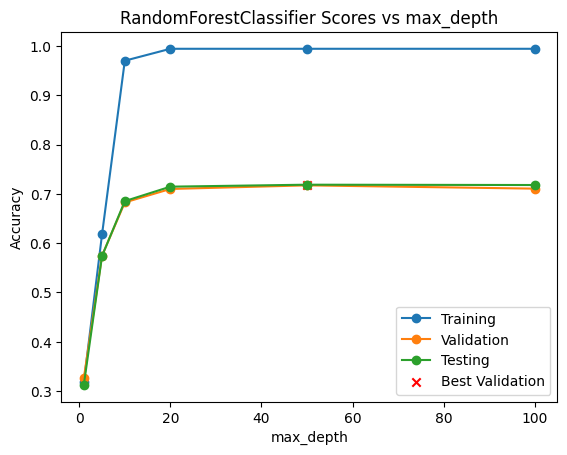

CPU times: user 1.43 s, sys: 98.7 ms, total: 1.53 s
Wall time: 1.44 s


In [ ]:
%%time
# Random Forest with "Entropy" Criterion
train_scores_RF_entropy = score_estimators(X_train_scaled, y_train, RF_entropy_estimators)
val_scores_RF_entropy = score_estimators(X_val_scaled, y_val, RF_entropy_estimators)
test_scores_RF_entropy = score_estimators(X_test_scaled, y_test, RF_entropy_estimators)

print("RF_entropy train scores:    ", train_scores_RF_entropy)
print("RF_entropy val scores:    ", val_scores_RF_entropy)
print("RF_entropy test scores:    ", test_scores_RF_entropy)

def plot_estimator_scores_RF_entropy(estimators, param_name, param_vals):
    """
    Plots the training, validation, and testing scores of a list of estimators,
    where `param_name` and `param_vals` are the same as for `train_estimators`.
    The estimator with the best validation score will be highlighted with an 'x'.
    """
    # Plotting
    plt.plot(param_vals, train_scores_RF_entropy, label='Training', marker='o')
    plt.plot(param_vals, val_scores_RF_entropy, label='Validation', marker='o')
    plt.plot(param_vals, test_scores_RF_entropy, label='Testing', marker='o')

    # Highlight the best validation score with an 'x'
    best_val_index = np.argmax(val_scores_RF_entropy)
    plt.scatter(param_vals[best_val_index], val_scores_RF_entropy[best_val_index], marker='x', color='red', label='Best Validation')

    # Set plot labels and title
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.title(f'{estimators[0].__class__.__name__} Scores vs {param_name}')
    plt.legend()
    plt.show()

# Use the instance in RandomForest_estimators function with param_name = 'max_depth' and param_vals = [1, 5, 10, 20, 50, 100]
RF_param_name = 'max_depth'
RF_param_vals = [1, 5, 10, 20, 50, 100]

# Example usage with RF_entropy
plot_estimator_scores_RF_entropy(RF_entropy_estimators, RF_param_name, RF_param_vals)

**Train multiple *LogisticRegression* classifiers** such that *train_estimators* produces the following output:

    Training LogisticRegression(C=1e-05, max_iter=10000, random_state=0)...
    Training LogisticRegression(C=0.0001, max_iter=10000, random_state=0)...
    Training LogisticRegression(C=0.001, max_iter=10000, random_state=0)...
    Training LogisticRegression(C=0.01, max_iter=10000, random_state=0)...
    Training LogisticRegression(C=0.1, max_iter=10000, random_state=0)...
    Training LogisticRegression(max_iter=10000, random_state=0)...
    
The omission of *C* when the final estimator was printed means it was trained with its default value, which is *C*=1. For example:
```python
>>> LogisticRegression(C=1.01)
LogisticRegression(C=1.01)

>>> LogisticRegression(C=1.0)
LogisticRegression()
```

In [ ]:
%%time
from sklearn.linear_model import LogisticRegression
# Create an instance of BaseEstimator(In this case LogisticRegression) with "max_iter" , "c" , and "random_state" hyperparameters
LR_estimator = LogisticRegression(max_iter=10000, random_state=0)

# Use the instance in LogisticRegression_estimators function with param_name = 'C' and param_vals = [1e-05, 0.0001, 0.001, 0.01, 0.1, 1]
LR_param_name = 'C'
LR_param_vals = [1e-05, 0.0001, 0.001, 0.01, 0.1, 1]

LR_estimators = train_estimators(LR_estimator.__class__, X_train_scaled, y_train, LR_param_name, LR_param_vals)

# Print the list of trained models
print('Training LogisticRegression ')
print(LR_estimators)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

Training LogisticRegression 
[LogisticRegression(C=1e-05), LogisticRegression(C=0.0001), LogisticRegression(C=0.001), LogisticRegression(C=0.01), LogisticRegression(C=0.1), LogisticRegression(C=1)]
CPU times: user 32.1 s, sys: 3.73 s, total: 35.8 s
Wall time: 21.3 s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


**Plot the *LogisticRegression* scores**, again by calling your *plot_estimator_scores* function.

LR train scores:     [0.41444444444444445, 0.5568888888888889, 0.6224444444444445, 0.6913333333333334, 0.774, 0.8015555555555556]
LR val scores:     [0.434, 0.5406666666666666, 0.5766666666666667, 0.6126666666666667, 0.606, 0.5646666666666667]
LR test scores:     [0.4086666666666667, 0.5353333333333333, 0.5766666666666667, 0.5933333333333334, 0.5826666666666667, 0.552]


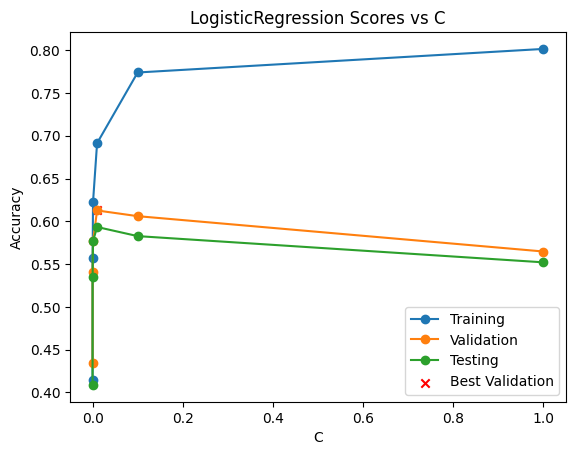

CPU times: user 692 ms, sys: 237 ms, total: 929 ms
Wall time: 553 ms


In [ ]:
%%time
# Logistic Regression
train_scores_LR = score_estimators(X_train_scaled, y_train, LR_estimators)
val_scores_LR = score_estimators(X_val_scaled, y_val, LR_estimators)
test_scores_LR = score_estimators(X_test_scaled, y_test, LR_estimators)

print("LR train scores:    ", train_scores_LR)
print("LR val scores:    ", val_scores_LR)
print("LR test scores:    ", test_scores_LR)

def plot_estimator_scores_LR(estimators, param_name, param_vals):
    """
    Plots the training, validation, and testing scores of a list of estimators,
    where `param_name` and `param_vals` are the same as for `train_estimators`.
    The estimator with the best validation score will be highlighted with an 'x'.
    """
    # Plotting
    plt.plot(param_vals, train_scores_LR, label='Training', marker='o')
    plt.plot(param_vals, val_scores_LR, label='Validation', marker='o')
    plt.plot(param_vals, test_scores_LR, label='Testing', marker='o')

    # Highlight the best validation score with an 'x'
    best_val_index = np.argmax(val_scores_LR)
    plt.scatter(param_vals[best_val_index], val_scores_LR[best_val_index], marker='x', color='red', label='Best Validation')

    # Set plot labels and title
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.title(f'{estimators[0].__class__.__name__} Scores vs {param_name}')
    plt.legend()
    plt.show()

# Use the instance in LogisticRegression_estimators function with param_name = 'C' and param_vals = [1e-05, 0.0001, 0.001, 0.01, 0.1, 1]
LR_param_name = 'C'
LR_param_vals = [1e-05, 0.0001, 0.001, 0.01, 0.1, 1]

# Example usage with LR
plot_estimator_scores_LR(LR_estimators, LR_param_name, LR_param_vals)

**Train multiple SVM classifiers (*SVC*)** such that *train_estimators* produces the following output:

    Training SVC(C=0.01, gamma=0.001, max_iter=10000, random_state=0)...
    Training SVC(C=0.1, gamma=0.001, max_iter=10000, random_state=0)...
    Training SVC(gamma=0.001, max_iter=10000, random_state=0)...
    Training SVC(C=10.0, gamma=0.001, max_iter=10000, random_state=0)...
    Training SVC(C=100.0, gamma=0.001, max_iter=10000, random_state=0)...
    Training SVC(C=1000.0, gamma=0.001, max_iter=10000, random_state=0)...

In [ ]:
%%time
from sklearn.svm import SVC
# Create an instance of BaseEstimator(In this case SVC) with "rbf" Kernel
SVC_estimator_rbf = SVC(kernel='rbf', gamma=0.001, max_iter=10000, random_state=0)

# Create an instance of BaseEstimator(In this case SVC) with 'linear' criterion
SVC_estimator_linear = SVC(kernel='linear', gamma=0.001, max_iter=10000, random_state=0)

# Use the instance in SVC_estimators function with param_name = 'C' and param_vals = [0.01, 0.1, 1, 10, 100, 1000]
SVC_param_name = 'C'
SVC_param_vals = [0.01, 0.1, 1, 10, 100, 1000]

SVC_rbf_estimators = train_estimators(SVC_estimator_rbf.__class__, X_train_scaled, y_train, SVC_param_name, SVC_param_vals)
SVC_linear_estimators = train_estimators(SVC_estimator_linear.__class__, X_train_scaled, y_train, SVC_param_name, SVC_param_vals)


# Print the list of trained models
print('Training SVCClassifier with rbf criterion')
print(SVC_rbf_estimators)
print('')
print('============================================================================================================')
print('')
print('Training SVCClassifier with linear criterion')
print(SVC_linear_estimators)

Training SVCClassifier with rbf criterion
[SVC(C=0.01), SVC(C=0.1), SVC(C=1), SVC(C=10), SVC(C=100), SVC(C=1000)]


Training SVCClassifier with linear criterion
[SVC(C=0.01), SVC(C=0.1), SVC(C=1), SVC(C=10), SVC(C=100), SVC(C=1000)]
CPU times: user 1min 25s, sys: 219 ms, total: 1min 26s
Wall time: 1min 26s


**Plot the *SVM* scores**, again by calling your *plot_estimator_scores* function. Predictions may take several minutes to compute.

SVC_rbf train scores:     [0.34444444444444444, 0.5893333333333334, 0.8142222222222222, 0.9851111111111112, 0.994, 0.9944444444444445]
SVC_rbf val scores:     [0.3626666666666667, 0.5633333333333334, 0.6913333333333334, 0.7446666666666667, 0.7333333333333333, 0.7313333333333333]
SVC_rbf test scores:     [0.344, 0.5533333333333333, 0.6826666666666666, 0.7366666666666667, 0.7306666666666667, 0.732]


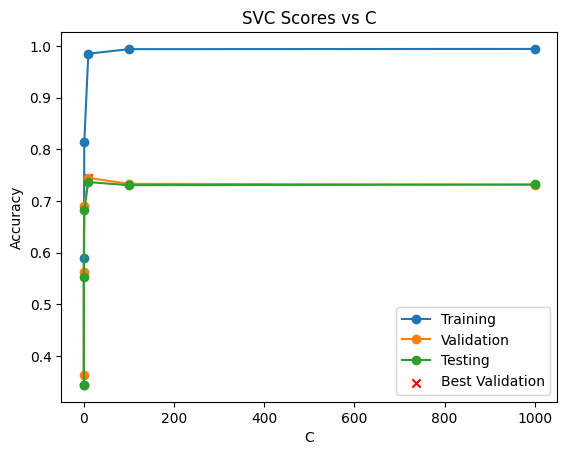

CPU times: user 2min 52s, sys: 362 ms, total: 2min 52s
Wall time: 3min 9s


In [ ]:
%%time
# SVC with "rbf" kernel
train_scores_SVC_rbf = score_estimators(X_train_scaled, y_train, SVC_rbf_estimators)
val_scores_SVC_rbf = score_estimators(X_val_scaled, y_val, SVC_rbf_estimators)
test_scores_SVC_rbf = score_estimators(X_test_scaled, y_test, SVC_rbf_estimators)

print("SVC_rbf train scores:    ", train_scores_SVC_rbf)
print("SVC_rbf val scores:    ", val_scores_SVC_rbf)
print("SVC_rbf test scores:    ", test_scores_SVC_rbf)

def plot_estimator_scores_SVC_rbf(estimators, param_name, param_vals):
    """
    Plots the training, validation, and testing scores of a list of estimators,
    where `param_name` and `param_vals` are the same as for `train_estimators`.
    The estimator with the best validation score will be highlighted with an 'x'.
    """
    # Plotting
    plt.plot(param_vals, train_scores_SVC_rbf, label='Training', marker='o')
    plt.plot(param_vals, val_scores_SVC_rbf, label='Validation', marker='o')
    plt.plot(param_vals, test_scores_SVC_rbf, label='Testing', marker='o')

    # Highlight the best validation score with an 'x'
    best_val_index = np.argmax(val_scores_SVC_rbf)
    plt.scatter(param_vals[best_val_index], val_scores_SVC_rbf[best_val_index], marker='x', color='red', label='Best Validation')

    # Set plot labels and title
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.title(f'{estimators[0].__class__.__name__} Scores vs {param_name}')
    plt.legend()
    plt.show()

# Use the instance in SVC_estimators function with param_name = 'C' and param_vals = [0.01, 0.1, 1, 10, 100, 1000]
SVC_param_name = 'C'
SVC_param_vals = [0.01, 0.1, 1, 10, 100, 1000]

# Example usage with SVC_rbf
plot_estimator_scores_SVC_rbf(SVC_rbf_estimators, SVC_param_name, SVC_param_vals)

SVC_linear train scores:     [0.34444444444444444, 0.5893333333333334, 0.8142222222222222, 0.9851111111111112, 0.994, 0.9944444444444445]
SVC_linear val scores:     [0.3626666666666667, 0.5633333333333334, 0.6913333333333334, 0.7446666666666667, 0.7333333333333333, 0.7313333333333333]
SVC_linear test scores:     [0.344, 0.5533333333333333, 0.6826666666666666, 0.7366666666666667, 0.7306666666666667, 0.732]


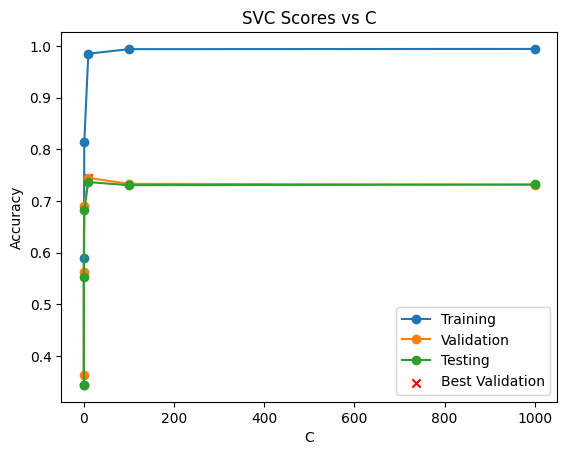

CPU times: user 2min 53s, sys: 271 ms, total: 2min 54s
Wall time: 3min 7s


In [ ]:
%%time
# SVC with "linear" kernel
train_scores_SVC_linear = score_estimators(X_train_scaled, y_train, SVC_linear_estimators)
val_scores_SVC_linear = score_estimators(X_val_scaled, y_val, SVC_linear_estimators)
test_scores_SVC_linear = score_estimators(X_test_scaled, y_test, SVC_linear_estimators)

print("SVC_linear train scores:    ", train_scores_SVC_linear)
print("SVC_linear val scores:    ", val_scores_SVC_linear)
print("SVC_linear test scores:    ", test_scores_SVC_linear)

def plot_estimator_scores_SVC_linear(estimators, param_name, param_vals):
    """
    Plots the training, validation, and testing scores of a list of estimators,
    where `param_name` and `param_vals` are the same as for `train_estimators`.
    The estimator with the best validation score will be highlighted with an 'x'.
    """
    # Plotting
    plt.plot(param_vals, train_scores_SVC_linear, label='Training', marker='o')
    plt.plot(param_vals, val_scores_SVC_linear, label='Validation', marker='o')
    plt.plot(param_vals, test_scores_SVC_linear, label='Testing', marker='o')

    # Highlight the best validation score with an 'x'
    best_val_index = np.argmax(val_scores_SVC_linear)
    plt.scatter(param_vals[best_val_index], val_scores_SVC_linear[best_val_index], marker='x', color='red', label='Best Validation')

    # Set plot labels and title
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.title(f'{estimators[0].__class__.__name__} Scores vs {param_name}')
    plt.legend()
    plt.show()

# Use the instance in SVC_estimators function with param_name = 'C' and param_vals = [0.01, 0.1, 1, 10, 100, 1000]
SVC_param_name = 'C'
SVC_param_vals = [0.01, 0.1, 1, 10, 100, 1000]

# Example usage with SVC_linear
plot_estimator_scores_SVC_linear(SVC_linear_estimators, SVC_param_name, SVC_param_vals)

<div style="border-bottom: 3px solid black; margin-bottom:5px"></div>
<div style="border-bottom: 3px solid black"></div>

# Visualizing mistakes

The goal here is to visualize classification errors, by confusion matrix and by inspecting typical mistakes.

<div style="border-bottom: 1px solid black;"></div>

### *Q3a &mdash;  Plot a confusion matrix for the best estimators

**Write code** to plot a confusion matrix for each of the 'best' estimators in **Q2** when applied to test set $(\boldsymbol{X}_\text{tst}, \boldsymbol{y}_\text{tst})$. Here, 'best' means best validation score. All estimators are already trained, so you can simply pull out the one best of each type {tree, forest, logistic, svm}. Use **[plot_confusion_matrix](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.plot_confusion_matrix.html)** or **[ConfusionMatrixDisplay](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.ConfusionMatrixDisplay.html)**.

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Find the best estimator for each type
best_tree_index = np.argmax(val_scores_tree)
best_RF_gini_index = np.argmax(val_scores_RF_gini)
best_RF_entropy_index = np.argmax(val_scores_RF_entropy)
best_LR_index = np.argmax(val_scores_LR)
best_SVC_rbf_index = np.argmax(val_scores_SVC_rbf)
best_SVC_linear_index = np.argmax(val_scores_SVC_linear)


best_tree_estimator = tree_estimators[best_tree_index]
best_RF_gini_estimator = RF_gini_estimators[best_RF_gini_index]
best_RF_entropy_estimator = RF_gini_estimators[best_RF_entropy_index]
best_LR_estimator = LR_estimators[best_LR_index]
best_SVC_rbf_estimator = SVC_rbf_estimators[best_SVC_rbf_index]
best_SVC_linear_estimator = SVC_linear_estimators[best_SVC_linear_index]


# Make predictions on the test set
y_pred_tree = best_tree_estimator.predict(X_test_scaled)
y_pred_RF_gini = best_RF_gini_estimator.predict(X_test_scaled)
y_pred_RF_entropy = best_RF_entropy_estimator.predict(X_test_scaled)
y_pred_LR = best_LR_estimator.predict(X_test_scaled)
y_pred_SVC_rbf = best_SVC_rbf_estimator.predict(X_test_scaled)
y_pred_SVC_linear = best_SVC_linear_estimator.predict(X_test_scaled)

# Plot confusion matrices using ConfusionMatrixDisplay
disp_tree = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_tree))
disp_RF_gini = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_RF_gini))
disp_RF_entropy = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_RF_entropy))
disp_LR = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_LR))
disp_SVC_rbf = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_SVC_rbf))
disp_SVC_linear = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_SVC_linear))

Text(0.5, 1.0, 'Confusion Matrix - Decision Tree')

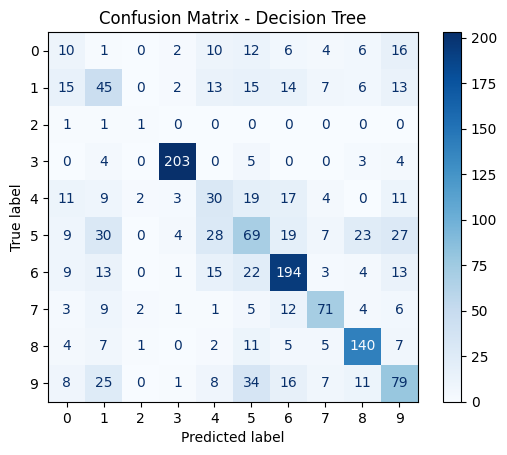

In [ ]:
# Plot confusion matrix for Decision Tree
disp_tree.plot(cmap='Blues', values_format='d')
plt.title('Confusion Matrix - Decision Tree')

Text(0.5, 1.0, 'Confusion Matrix - Random Forest (Gini)')

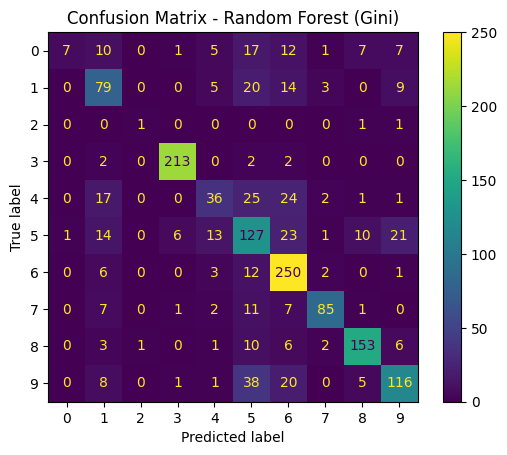

In [ ]:
# Plot confusion matrix for Random Forest (Gini)
disp_RF_gini.plot(cmap='viridis', values_format='d')
plt.title('Confusion Matrix - Random Forest (Gini)')

Text(0.5, 1.0, 'Confusion Matrix - Random Forest (Entropy)')

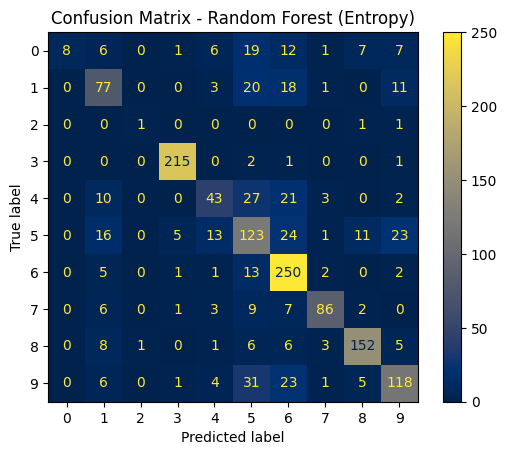

In [ ]:
# Plot confusion matrix for Random Forest (Entropy)
disp_RF_entropy.plot(cmap='cividis', values_format='d')
plt.title('Confusion Matrix - Random Forest (Entropy)')

Text(0.5, 1.0, 'Confusion Matrix - Logistic Regression')

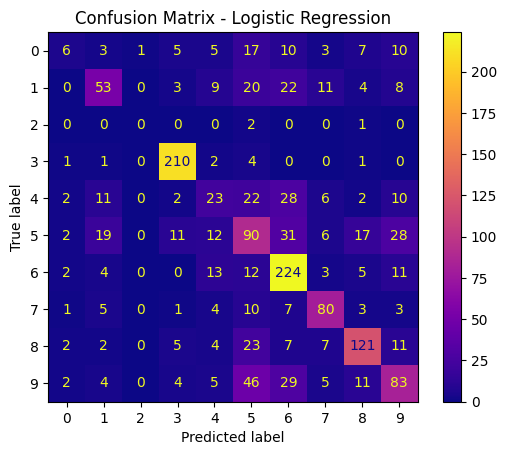

In [ ]:
# Plot confusion matrix for Logistic Regression
disp_LR.plot(cmap='plasma', values_format='d')
plt.title('Confusion Matrix - Logistic Regression')

Text(0.5, 1.0, 'Confusion Matrix - SVM (RBF Kernel)')

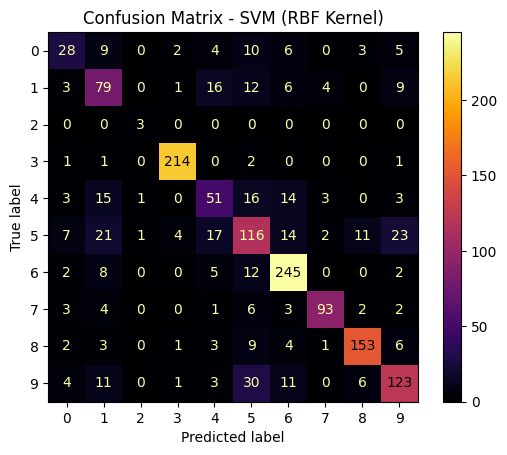

In [ ]:
# Plot confusion matrix for SVM (RBF Kernel)
disp_SVC_rbf.plot(cmap='inferno', values_format='d')
plt.title('Confusion Matrix - SVM (RBF Kernel)')

Text(0.5, 1.0, 'Confusion Matrix - SVM (Linear Kernel)')

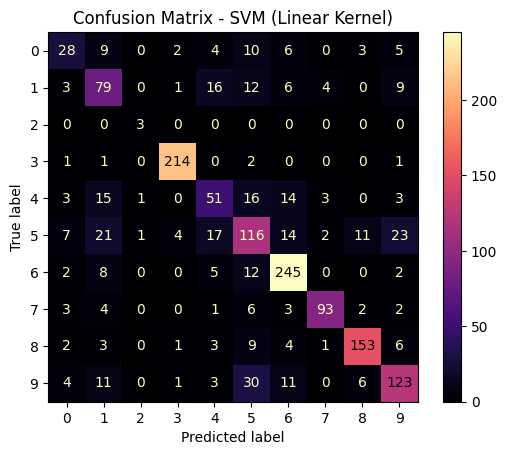

In [ ]:
# Plot confusion matrix for SVM (Linear Kernel)
disp_SVC_linear.plot(cmap='magma', values_format='d')
plt.title('Confusion Matrix - SVM (Linear Kernel)')